In [1]:
# Import libraries
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import io
import imageio
from IPython.display import Image as IPythonImage, display
from matplotlib.animation import FuncAnimation, PillowWriter
from matplotlib.ticker import MaxNLocator
from IPython.display import HTML
import time
plt.rcParams['figure.dpi'] = 30

# Let's consider the case where we have migration and mutation, each episode is a new realization of reality, in which we have the agent to choose wether to mutate into new bin (at the same node), or jumb at the same bin to another node (based on its connectivety matrix) at each step. Then we investigate what was the optimum policy for the agent with $n$ having $\textit{decay_factor}$, and $h$ that has a chance of changing its value by +1 depending on the number $n$ and $\textit{immune_factor}$ at all the bins in this node

In [9]:
# Define the number of nodes and discretization bins
num_nodes = 4
num_bins = 20
x = np.linspace(0,num_bins,num_bins+1)[1:] # antigenic space


# Define the random decay_factor for n and increase immunity_factor in h
decay_factor = 0.1
immune_factor = 1e-3


# Q-learning parameters for an epsilon greedy policy
learning_rate = 0.1
discount_factor = 0.9
epsilon = 0.1

# Define the initial values of n for node and bin (they change to zero in the loop itself)
n = np.ones((num_nodes, num_bins))

# Initialize Q-values table
num_actions = 2  # Two actions: 0 - Mutate, 1 - Jump
Q = np.zeros((num_nodes, num_bins, num_actions))

# Define the weight matrix used to get the probabilty connectivity matrix

# Random weights:
weight_matrix = np.array([[0.01, 1, 0.5, 0.3],
                          [1, 0.01, 0.2, 0.7],
                          [0.1, 0.4, 0.01, 1],
                          [0.6, 0.3, 1, 0.01]])
# Well mixed:
# weight_matrix = np.array([[0.01, 1, 1, 1],
#                           [1, 0.01, 1, 1],
#                           [1, 1, 0.01, 1],
#                           [1, 1, 1, 0.01]])

# Migrate to only one neighbour:
# weight_matrix = np.array([[0.01, 1, 0.01, 1],
#                           [1, 0.01, 0.01, 0.01],
#                           [0.01, 0.01, 0.01, 1],
#                           [1, 0.01, 1, 0.01]])

connectivity_matrix = np.zeros((num_nodes,num_nodes))
# Normalize to get probabilities
for i in range(num_nodes):
    connectivity_matrix[i,:] = weight_matrix[i,:]/sum(weight_matrix[i,:])

# Define the number of episodes and maximum steps per episode
num_episodes = 100
max_steps = 1000

# Initialize the total rewards for each episode
total_rewards = []

# Initialize the history of n and Q over time
n_history = np.zeros((num_episodes, max_steps, num_nodes, num_bins))
h_history = np.zeros((num_episodes, max_steps, num_nodes))
Q_history = np.zeros((num_episodes, max_steps, num_nodes, num_bins, num_actions))

<Figure size 700x700 with 0 Axes>

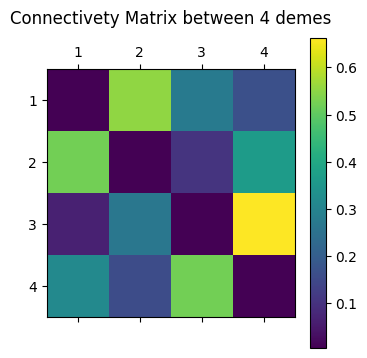

In [16]:
# Plot the connectivety matrix
plt.figure(figsize=(7,7));
plt.matshow(connectivity_matrix);
plt.colorbar();
plt.xticks(ticks=np.arange(0,4),labels=np.arange(1,5));
plt.yticks(ticks=np.arange(0,4),labels=np.arange(1,5));
plt.title('Connectivety Matrix between 4 demes', y=1.15);

Episode: 0 Total Reward: 206309.0
Episode: 50 Total Reward: 104304.0


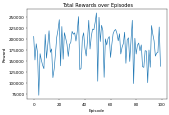

Iteration = 1 Time = 32.689950466156006
Episode: 0 Total Reward: 188935.0
Episode: 50 Total Reward: 237685.0


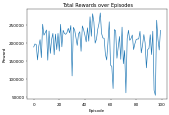

Iteration = 2 Time = 37.95285224914551
Episode: 0 Total Reward: 176642.0
Episode: 50 Total Reward: 127542.0


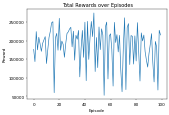

Iteration = 3 Time = 37.40819025039673
Episode: 0 Total Reward: 157691.0
Episode: 50 Total Reward: 182762.0


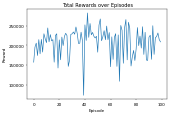

Iteration = 4 Time = 40.074429512023926
Episode: 0 Total Reward: 198189.0
Episode: 50 Total Reward: 195962.0


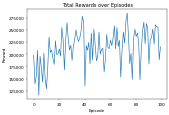

Iteration = 5 Time = 38.52744722366333
Episode: 0 Total Reward: 211014.0
Episode: 50 Total Reward: 220506.0


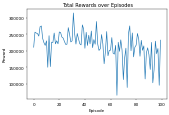

Iteration = 6 Time = 38.6400089263916
Episode: 0 Total Reward: 188452.0
Episode: 50 Total Reward: 260391.0


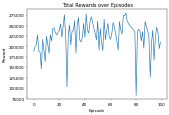

Iteration = 7 Time = 41.64611601829529
Episode: 0 Total Reward: 130379.0
Episode: 50 Total Reward: 224077.0


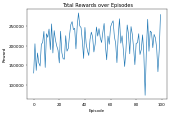

Iteration = 8 Time = 39.14004445075989
Episode: 0 Total Reward: 150876.0
Episode: 50 Total Reward: 224969.0


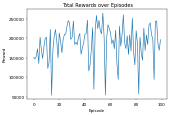

Iteration = 9 Time = 37.925522565841675
Episode: 0 Total Reward: 124806.0
Episode: 50 Total Reward: 210107.0


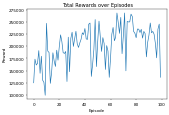

Iteration = 10 Time = 41.611528396606445
Episode: 0 Total Reward: 195873.0
Episode: 50 Total Reward: 133176.0


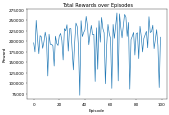

Iteration = 11 Time = 39.14377951622009
Episode: 0 Total Reward: 161644.0
Episode: 50 Total Reward: 236060.0


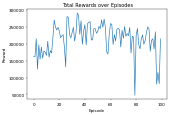

Iteration = 12 Time = 37.59924125671387
Episode: 0 Total Reward: 175513.0
Episode: 50 Total Reward: 199281.0


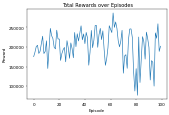

Iteration = 13 Time = 43.26687431335449
Episode: 0 Total Reward: 122820.0
Episode: 50 Total Reward: 216113.0


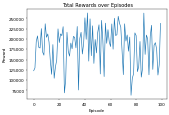

Iteration = 14 Time = 37.370253801345825
Episode: 0 Total Reward: 205543.0
Episode: 50 Total Reward: 256623.0


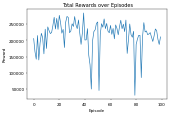

Iteration = 15 Time = 39.20094442367554
Episode: 0 Total Reward: 136296.0
Episode: 50 Total Reward: 195093.0


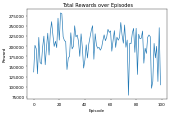

Iteration = 16 Time = 43.48277020454407
Episode: 0 Total Reward: 108474.0
Episode: 50 Total Reward: 201127.0


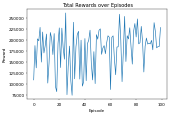

Iteration = 17 Time = 39.06576466560364
Episode: 0 Total Reward: 171750.0
Episode: 50 Total Reward: 221453.0


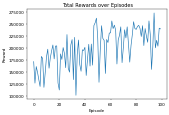

Iteration = 18 Time = 37.952784061431885
Episode: 0 Total Reward: 169741.0
Episode: 50 Total Reward: 224827.0


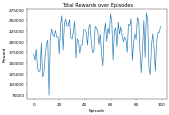

Iteration = 19 Time = 42.122105836868286
Episode: 0 Total Reward: 176465.0
Episode: 50 Total Reward: 228424.0


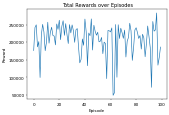

Iteration = 20 Time = 39.74903178215027
Episode: 0 Total Reward: 189034.0
Episode: 50 Total Reward: 236412.0


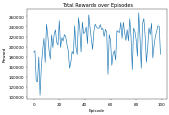

Iteration = 21 Time = 37.62225270271301
Episode: 0 Total Reward: 178203.0
Episode: 50 Total Reward: 208195.0


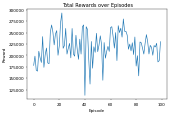

Iteration = 22 Time = 42.92866253852844
Episode: 0 Total Reward: 173463.0
Episode: 50 Total Reward: 260226.0


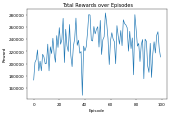

Iteration = 23 Time = 43.07050013542175
Episode: 0 Total Reward: 112349.0
Episode: 50 Total Reward: 100606.0


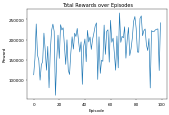

Iteration = 24 Time = 38.65983581542969
Episode: 0 Total Reward: 154344.0
Episode: 50 Total Reward: 106429.0


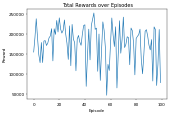

Iteration = 25 Time = 41.26408576965332


In [11]:
plt.rcParams['figure.dpi'] = 30

# Loop over multiple Q's to get its distrubtion
trials = 25 
Q_lst = np.zeros((trials, num_episodes, num_nodes, num_bins, num_actions))
h_lst = np.zeros((trials, num_episodes, num_nodes))
for l in range(trials):
  tic = time.time()
  Q = np.zeros((num_nodes, num_bins, num_actions)) # Initialize Q for each new trial, but stays same within episode
  total_rewards = []
  # Q-learning algorithm
  for episode in range(num_episodes):
      # Reset the environment to initial state
      n = np.zeros((num_nodes, num_bins))
      h = np.zeros(num_nodes)
      total_reward = 0

      # Randomly choose the current node for the agent
      current_node = np.random.randint(num_nodes)
      # Randomly choose current bin in the node for the "outbreak"
      current_bin = np.random.randint(num_bins)

      for step in range(max_steps):
          # Choose an action using epsilon-greedy policy, that's go for the last action, except with small prob epsilon to change that
          if np.random.uniform() < epsilon:
              action = np.random.randint(num_actions)
          else:
              action = np.argmax(Q[current_node, current_bin, :])

          # Take the chosen action and observe the next state and reward
          if action == 0:  # Mutate (change bin)
              next_node = current_node # No change in nodes
              next_bin = np.clip(current_bin + np.random.choice([-1,1]),0,num_bins-1)
              if next_bin <= h[current_node]:
                  n[current_node][next_bin] += 0
                  # Calculate the reward based on the change in n
                  reward = np.sum(n)
              else:
                  n[current_node][next_bin] += 1
                  current_bin = next_bin # Transition to the next bin
                  # Calculate the reward based on the change in n
                  reward = np.sum(n)

          else:  # Jump to another node based on connectivety matrix
              next_bin = current_bin # No change in bin
              next_node = np.random.choice(num_nodes, p=connectivity_matrix[current_node])
              # Calculate the reward based on h(x) to determine if the agent survives
              if current_bin <= h[next_node]:
                  n[next_node][current_bin] += 0
                  # Calculate the reward based on the change in n
                  reward = np.sum(n)
              else:
                  n[next_node][current_bin] += 1
                  # Move to that node
                  current_node = next_node
                  # Calculate the reward based on the change in n
                  reward = np.sum(n)

          # Update the Q-value for the chosen state-action pair using the Q-learning update rule
          Q[current_node, current_bin, action] += learning_rate * (reward + discount_factor * np.max(Q[next_node, next_bin, :]) - Q[current_node, current_bin, action])

          # Update the state of n by some decay according to tau dropping with probabilty of decay_factor in all nodes
          # Update the state of h by some chance in adding immunity with probablity that depends on immune_factor in all the nodes
          for k in range(num_nodes):
            # Death
            n[k] -= np.random.poisson((decay_factor * n[k]).astype('int'))
            n[k][n[k]<0]=0 # check if n is less than 0 and set it to 0
            # Immunity
            h[k] += np.random.choice([1,0],p=[sum(immune_factor * n[k,:])/(sum(immune_factor * n[k,:])+1),1/(sum(immune_factor * n[k,:])+1)])

          h[h>x[-1]]=x[-1] # check if h is more than the last bin in x and set it to this value

          # Add reward for each step
          total_reward += reward
          # Update the population function based on the chosen action
          n_history[episode, step, :, :] = n
          h_history[episode,step,:] = h
          Q_history[episode, step, :, :, :] = Q

      # Store the total reward achieved in each episode
      total_rewards.append(total_reward)

      # Print the total reward achieved after 50 episodes
      if episode % 50 == 0:
          print("Episode:", episode, "Total Reward:", total_reward)

  # Plot the total rewards over episodes
  plt.plot(np.array(total_rewards))
  plt.ylim(0)
  plt.xlabel('Episode')
  plt.ylabel('Reward')
  plt.title('Total Rewards over Episodes')
  plt.show()

  # Save the Q's and h's
  toc = time.time()
  print('Iteration = '+str(l+1), ', Time = '+str(toc-tic))
  Q_lst[l,:] = Q_history[:,-1,:,:,:]
  h_lst[l,:] = h_history[:,-1,:]

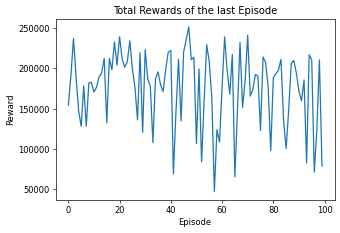

In [36]:
plt.rcParams['figure.dpi'] = 60
# Plot the total rewards of the last episode
plt.plot(np.array(total_rewards))
# plt.ylim(1)
# plt.yscale('log')
plt.xlabel('Episode')
plt.ylabel('Reward')
plt.title('Total Rewards of the last Episode')
plt.show()


In [18]:
# Function to simulate agent movement based on Q-values and given T steps
def simulate_agent_movement(Q, T):
    n_history = np.zeros((T + 1, num_nodes, num_bins))
    h_history = np.zeros((T + 1, num_nodes))
    n = np.zeros((num_nodes, num_bins))
    h = np.zeros(num_nodes)

    for t in range(T + 1):
        # Randomly choose the current node for the agent
        current_node = np.random.randint(num_nodes)
        # Current bin in the node
        current_bin = np.random.randint(num_bins)
        # Choose an action using Q-values
        action = np.argmax(Q[current_node, current_bin, :])

        if action == 0:  # Mutate (change bin)
            next_bin = np.clip(current_bin + np.random.choice([-1,1]),0,num_bins-1)
            if next_bin <= h[current_node]:
                n[current_node][next_bin] += 0
            else:
                n[current_node][next_bin] += 1
                current_bin = next_bin # Transition to the next bin
        else:  # Jump to another node based on connectivety matrix
            next_node = np.random.choice(num_nodes, p=connectivity_matrix[current_node])
            # Calculate the reward based on h(x) to determine if the agent survives
            if current_bin <= h[next_node]:
                n[next_node][current_bin] += 0
            else:
                n[next_node][current_bin] += 1
                # Move to that node
                current_node = next_node # Transition to the next node

        for k in range(num_nodes):
            # Update the state of n by some decay according to tau dropping with probabilty of decay_factor in all nodes
            # Update the state of h by some chance in adding immunity with probablity that depends on immune_factor in all the nodes
            # Death
            n[k] -= np.random.poisson((decay_factor * n[k]).astype('int'))
            n[k][n[k]<0]=0 # check if n is less than 0 and set it to 0
            # Immunity
            h[k] += np.random.choice([1,0],p=[sum(immune_factor * n[k,:])/(sum(immune_factor * n[k,:])+1),1/(sum(immune_factor * n[k,:])+1)])

        h[h>x[-1]]=x[-1] # check if b is more than the last bin in x and set it to this value

        n_history[t] = n
        h_history[t] = h
    return n_history, h_history

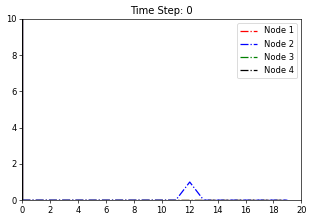

In [19]:
# Create the GIF by simulating over T time points, for the Q we learnt in the last trial 
T = 500
n_history, b_history = simulate_agent_movement(Q, T)

fig, ax = plt.subplots()
plt.xlabel('x')
plt.ylabel('n')
plt.title('Agent Movement in the Environment')

clr_lst = ['r','b','g','k']

# Define the update function for the GIF, show the first frame
def update(frame):
    ax.clear()
    ax.set_xlim(0, num_bins)
    ax.set_ylim(0, np.amax(n_history))
    ax.set_title(f'Time Step: {frame}')
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))

    for node in range(num_nodes):
        ax.plot(n_history[frame, node, :], '-.'+str(clr_lst[node]), label=f'Node {node+1}')
        ax.plot(b_history[frame,node]*np.ones(10),np.linspace(0,1.05*np.amax(n_history),10), '-'+str(clr_lst[node]))#,  label=f'b =  {x[int(b_history[node])]}')

    ax.legend(loc='upper right')

# Make the animation
ani = FuncAnimation(fig, update, frames=T + 1, interval=100)

# Save the animation as a GIF:
# ani.save('agent_movement.gif', writer='pillow', fps=5)


In [20]:
# Show the animation (takes time)
HTML(ani.to_jshtml())

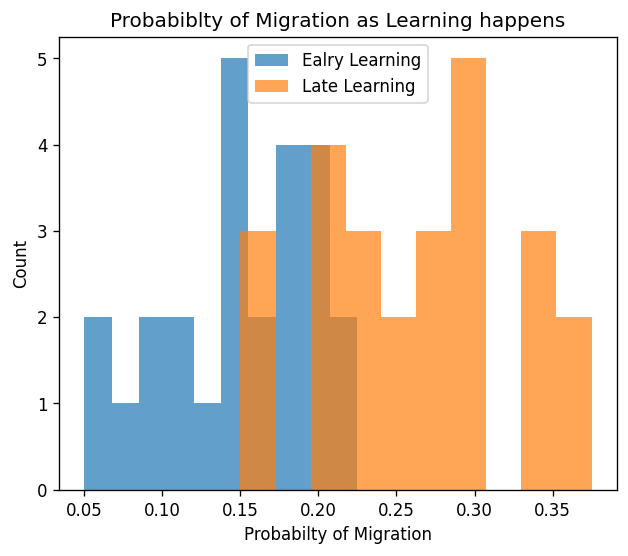

In [23]:
plt.rcParams['figure.dpi'] = 120

# Plot the probabitly of migration for the first and last episode of learning, probability obtained from ntrials
plt.figure(figsize=(6,5))
plt.hist(np.average(np.average(np.argmax(Q_lst[:,0,:,:,:],axis=3),axis=2),axis=1), bins=10, label='Ealry Learning', alpha=0.7)
plt.hist(np.average(np.average(np.argmax(Q_lst[:,-1,:,:,:],axis=3),axis=2),axis=1), bins=10, label='Late Learning', alpha=0.7);
plt.legend();
plt.xlabel('Probabilty of Migration')
plt.title('Probabiblty of Migration as Learning happens');
plt.ylabel('Count');

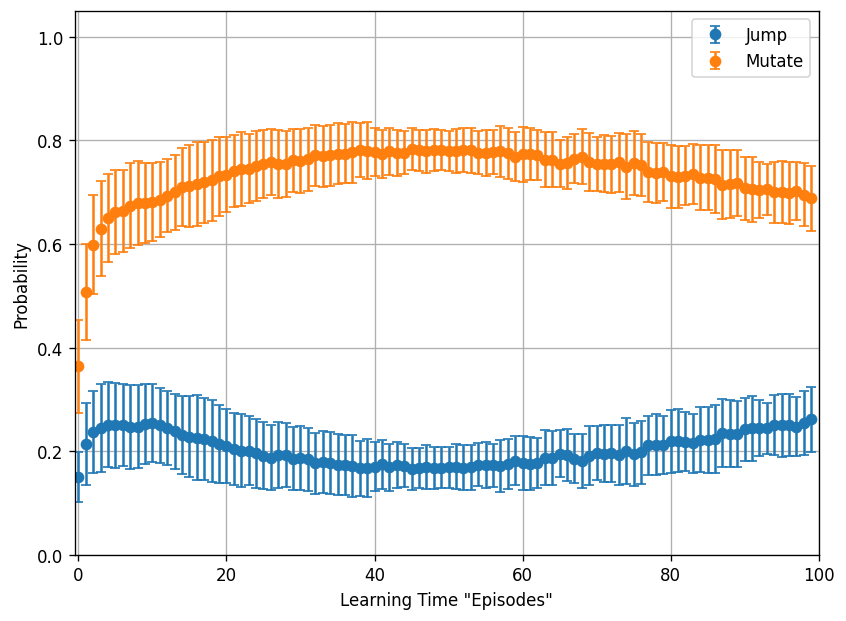

In [25]:
# Calculate the mean and standard deviation along the t_steps axis
mean_data_j = np.mean(np.average(np.average(np.argmax(Q_lst[:,:,:,:,:],axis=4),axis=3),axis=2), axis=0)
std_data_j = np.std(np.average(np.average(np.argmax(Q_lst[:,:,:,:,:],axis=4),axis=3),axis=2), axis=0)

mean_data_m = np.mean(np.average(np.average(np.argmin(Q_lst[:,:,:,:,:],axis=4),axis=3),axis=2), axis=0)
std_data_m = np.std(np.average(np.average(np.argmin(Q_lst[:,:,:,:,:],axis=4),axis=3),axis=2), axis=0)

# Plot the mean with error bars
plt.figure(figsize=(8,6))
plt.errorbar(np.arange(num_episodes),mean_data_j, yerr=std_data_j, fmt='o', capsize=3, label='Jump')
plt.errorbar(np.arange(num_episodes),mean_data_m, yerr=std_data_m, fmt='o', capsize=3, label='Mutate')
plt.xlabel('Learning Time "Episodes"')
plt.ylabel('Probability')
#plt.title('Average over 25 Relizations with Error Bars (1 Standard Deviation)')
plt.grid(True)
plt.legend();
plt.xlim(-0.5,num_episodes)
plt.ylim(0,1.05)
plt.show()